### Import Libraries

In [80]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import keras
# import seaborn as sns

# from tensorflow.keras.callbacks import ModelCheckpoint
from keras.losses import BinaryCrossentropy
from keras.models import load_model
from keras.utils.vis_utils import plot_model
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D,Conv2DTranspose
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.image import resize

from pytorch_fid import fid_score

from scipy.linalg import sqrtm
from scipy.stats import entropy

from numpy import expand_dims
from numpy import ones
from numpy import zeros
from numpy.random import rand,randn
from numpy.random import randint

from matplotlib import pyplot

In [2]:
tf.keras.backend.clear_session()

In [3]:
tf.config.experimental.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
# gpus = tf.config.experimental.list_physical_devices('GPU')
# for gpu in gpus:
#   tf.config.experimental.set_memory_growth(gpu, True)

### Load & Split Dataset

In [81]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.cifar10.load_data()

In [82]:
# got it from the website
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

### Exploratory Data Analysis (EDA)

##### displaying 5 images from each class

In [7]:
def display_images(X_train, y_train, class_names):
  fig, axes = plt.subplots(5, 10, figsize=(20, 10))
  for class_label in range(10):
      class_images = X_train[y_train.flatten() == class_label]

      for i in range(5):
          plt.subplot(5, 10, class_label + i * 10 + 1)
          plt.imshow(class_images[i])
          plt.title(class_names[class_label])
          plt.axis('off')

  plt.show()

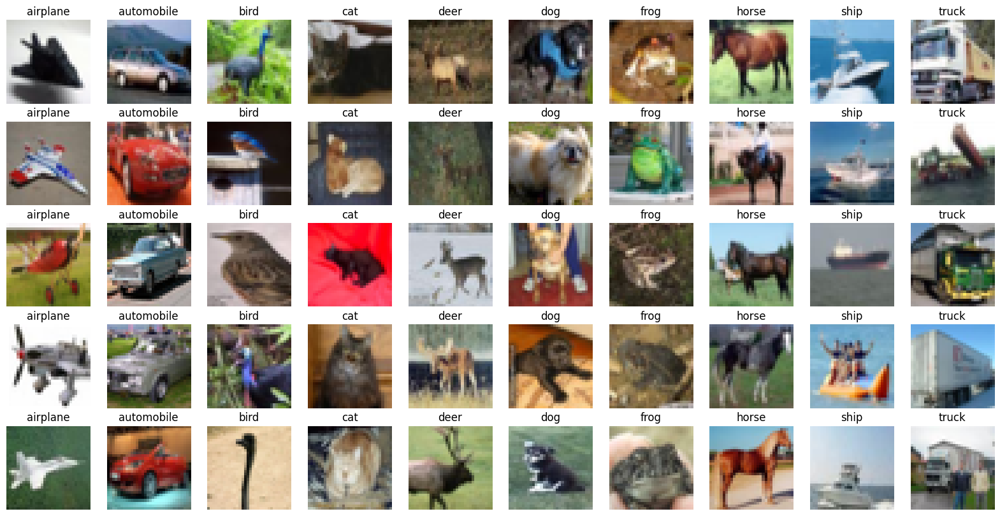

In [8]:
display_images(X_train, y_train, class_names)

##### not all animals/vehicles are pointing/facing the same side. 

In [9]:
#flatten images
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

all_images = np.concatenate((X_train_flat, X_test_flat), axis=0)

#checking for unique images
unique_indices = np.unique(all_images, axis=0, return_index=True)[1]

num_unique_images = len(unique_indices)
total_images = len(all_images)
print(f"number of unique images: {num_unique_images}/{total_images}")

number of unique images: 60000/60000


all 60 000 images in cifar10 dataset are unique, no duplicates

##### Exploring the dataset and discovering similarities on how we can augment later on

In [10]:
print("Training set shape:", X_train.shape)
print("Number of training samples:", X_train.shape[0])
print("Number of test samples:", X_test.shape[0])
print("Image shape:", X_train[0].shape)
print("Label shape:", y_train.shape)

Training set shape: (50000, 32, 32, 3)
Number of training samples: 50000
Number of test samples: 10000
Image shape: (32, 32, 3)
Label shape: (50000, 1)


In [11]:
def get_class_distribution(y_train, y_test, class_names):

  # classes and their img counts (train)
  train_classes, train_counts = np.unique(y_train, return_counts=True)

  # classes and their img counts (test)
  test_classes, test_counts = np.unique(y_test, return_counts=True)

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

  # bar chart for training set
  ax1.barh(class_names, train_counts, color='blue')
  ax1.set_title('Class distribution in training set')

  # bar chart for test set
  ax2.barh(class_names, test_counts, color='orange')
  ax2.set_title('Class distribution in test set')

  plt.show()

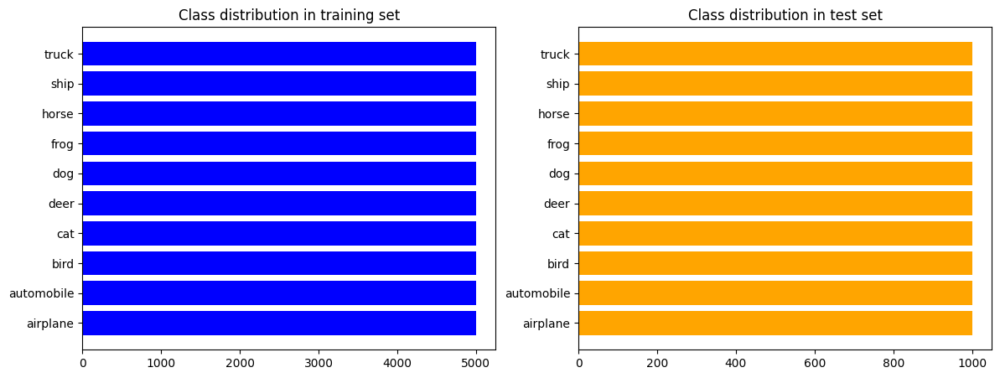

In [12]:
get_class_distribution(y_train, y_test, class_names)

Classes are distributed evenly accross the dataset

In [13]:
def pixel_distribution(X_train):
  plt.hist(X_train.flatten(), bins=255, color='blue', alpha=0.5)
  plt.title("Distribution of Pixel Values in Training Images")
  plt.xlabel("Pixel Value")
  plt.ylabel("Frequency")
  plt.show()

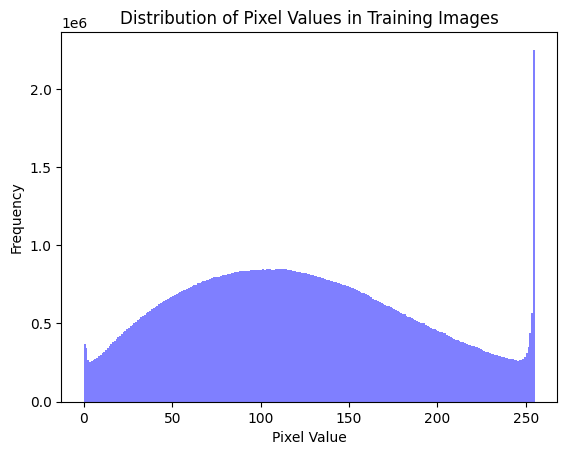

In [14]:
pixel_distribution(X_train)

Relatively normal distribution. Pixel values are concentrated around a central mean value.

### loading and generating samples

In [83]:
def load_real_samples():
    # load cifar10 dataset
    (X_train, _), (_, _) = tf.keras.datasets.cifar10.load_data()
    # convert from unsigned ints to floats
    X = X_train.astype('float32')
    # scale from [0,255] to [-1,1]
    X = (X - 127.5) / 127.5
    
    return X

In [84]:
def generate_real_samples(dataset, n_samples):
    # choose random instances
    ix = randint(0, dataset.shape[0], n_samples)
    # retrieve selected images
    X = dataset[ix]
    # generate 'real' class labels (1)
    y = ones((n_samples, 1))
    
    return X, y

In [85]:
def generate_fake_samples(n_samples):
    # generate uniform random numbers in [0,1]
    X = rand(32 * 32 * 3 * n_samples)
    # update to have the range [-1, 1]
    X = -1 + X * 2
    # reshape into a batch of color images
    X = X.reshape((n_samples, 32, 32, 3))
    # generate 'fake' class labels (0)
    y = zeros((n_samples, 1))
    
    return X, y

### discriminator 

In [86]:
# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
    model = Sequential()
    # normal
    model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2)) #downsampling

    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Flatten())
    model.add(Dropout(0.4)) #prevents overfitting
    model.add(Dense(1, activation='sigmoid')) #discriminator is binary classifier (real or fake)
    
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    
    return model
 
# define model
model = define_discriminator()

# summarize the model
model.summary()

# plot the model
# plot_model(model, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True) 
# You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_101 (Conv2D)         (None, 32, 32, 64)        1792      
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_102 (Conv2D)         (None, 16, 16, 128)       73856     
                                                                 
 leaky_re_lu_11 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 conv2d_103 (Conv2D)         (None, 8, 8, 128)         147584    
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                                 
 conv2d_104 (Conv2D)         (None, 4, 4, 256)        

In [87]:
# train the discriminator model
def train_discriminator(model, dataset, n_iter=20, n_batch=64):
   half_batch = int(n_batch / 2)
   # manually enumerate epochs
   for i in range(n_iter):
   # get randomly selected 'real' samples
      X_real, y_real = generate_real_samples(dataset, half_batch)
      # update discriminator on real samples
      _, real_acc = model.train_on_batch(X_real, y_real)
      # generate 'fake' examples
      X_fake, y_fake = generate_fake_samples(half_batch)
      # update discriminator on fake samples
      _, fake_acc = model.train_on_batch(X_fake, y_fake)
      # summarize performance
      print('>%d real=%.0f%% fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

### generator

In [88]:
# define the standalone generator model
def define_generator(latent_dim):
    model = Sequential()
    # foundation for 4x4 image
    n_nodes = 256 * 4 * 4
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((4, 4, 256)))
    # upsample to 8x8
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 16x16
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 32x32
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # output layer
    model.add(Conv2D(3, (3,3), activation='tanh', padding='same'))
    
    return model

In [89]:
# generate points in latent space as input for the generator
# these generated points are often fed into the generator network of a GAN to produce synthetic data
# The generator takes these points from the latent space and transforms them into realistic-looking samples, which are then used to train the GAN.
def generate_latent_points(latent_dim, n_samples):
    latent_dim = int(latent_dim)
    n_samples = int(n_samples)

    # generate points in the latent space
    x_input = randn(latent_dim * n_samples)
    # reshape into a batch of inputs for the network
    x_input = x_input.reshape(n_samples, latent_dim)
    
    return x_input

In [90]:
# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
    # generate points in latent space
    x_input = generate_latent_points(latent_dim, n_samples)
    # predict outputs
    X = g_model.predict(x_input)
    # create 'fake' class labels (0)
    y = zeros((n_samples, 1))
    
    return X, y # returns both the generated fake samples (X) and their fake class labels (y).

### combined model (generator & discriminator)

In [91]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
    # make weights in the discriminator not trainable... why?
    # if the discriminator's weights were allowed to be updated during the generator training phase, it could quickly become too good at distinguishing between real and fake samples
    # helps stabilize the training process and encourages the generator to produce diverse and realistic samples.
    d_model.trainable = False

    model = Sequential()
    # add generator and discriminator
    model.add(g_model)
    model.add(d_model)

    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    
    return model

In [92]:
# train the composite model
def train_gan(gan_model, latent_dim, n_epochs=200, n_batch=128):

   for i in range(n_epochs):
      # generate inpputs for the generator
      x_gan = generate_latent_points(latent_dim, n_batch)
      # create inverted labels for the fake samples
      # creates a column vector of ones, indicating that these samples are "real" (even though they are actually fake)
      y_gan = ones((n_batch, 1))
      # update the generator via the discriminator's error
      gan_model.train_on_batch(x_gan, y_gan)

### saving generated image plots

In [25]:
def save_plot(examples, epoch, placeholder, n=7):
    # brings the pixel values into a standard image range.
    examples = (examples + 1) / 2.0
    # plot images
    for i in range(n * n):

        # define subplot
        plt.subplot(n, n, 1 + i)
        plt.axis('off')

        # plot raw pixel data
        plt.imshow(examples[i])

    # save plot to file    
    if placeholder == 'augmented':
        file_path = "augmented_img_gan"
    else:
        file_path = "epochs_img_gan"

    # file_path = "epochs_img_gan"
    filename = 'generated_plot_e%03d.png' % (epoch+1)
    location = os.path.join(file_path,filename)

    # check if the directory exists
    if not os.path.exists(file_path):
        print("Creating directory:", file_path)
        os.makedirs(file_path)

    plt.savefig(location)
    print("Plot successfully saved.")
    
    plt.close()

### Summarize Performance

In [26]:
# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, placeholder, n_samples=150):
    # prepare real samples
    X_real, y_real = generate_real_samples(dataset, n_samples)
    # evaluate discriminator on real examples
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    # prepare fake examples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
    # save plot
    save_plot(x_fake, epoch, placeholder)

    # save the generator model tile file
    if placeholder == 'augmented':
        file_path2 = "augmented_weights"
    else:
        file_path2 = "weights"
    

    # check if the directory exists
    if not os.path.exists(file_path2):
        print("Creating directory:", file_path2)
        os.makedirs(file_path2)

    filename2 = 'generator_model_%03d.h5' % (epoch+1)
    location2 = os.path.join(file_path2, filename2)
    print("Saving model to:", location2)
        
    g_model.save(location2)

### train combined model

In [93]:
def train(g_model, d_model, gan_model, dataset, latent_dim=100, n_epochs=200, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)
    d_losses = []
    g_losses = []
    # manually enumerate epochs
    for i in range(n_epochs):
        # enumerate batches over the training set
        for j in range(bat_per_epo):
            # get randomly selected 'real' samples
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # update discriminator model weights on real samples
            d_loss1, _ = d_model.train_on_batch(X_real, y_real)
            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # update discriminator model weights on fake samples
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            y_gan = ones((n_batch, 1))
            # update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
            print('Epoch %d/%d, Batch %d/%d, d1=%.3f, d2=%.3f, g=%.3f' %
                  (i+1, n_epochs, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
            
            # Append discriminator and generator losses
            d_losses.append((d_loss1 + d_loss2) / 2)
            g_losses.append(g_loss)
            
        print(f'Epoch {i+1}/{n_epochs} completed.')

        # evaluate the model performance after every 10 epochs
        if (i+1) % 10 == 0:
            summarize_performance(i, g_model, d_model, dataset, latent_dim, 'before_augmented')


    return d_losses, g_losses


In [28]:
def plot_loss(d_losses, g_losses):
    plt.figure(figsize=(10, 5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(g_losses, label="Generator")
    plt.plot(d_losses, label="Discriminator")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    # plt.show()
    save_path = "loss_plot.png"
    plt.savefig(save_path)
    plt.close()

    return save_path

In [29]:
# size of the latent space
latent_dim = 100

# create the discriminator
d_model = define_discriminator()

# create the generator
g_model = define_generator(latent_dim)

# create the gan
gan_model = define_gan(g_model, d_model)

# load image data
dataset = load_real_samples()

# Train the model
# d_losses, g_losses = train(g_model, d_model, gan_model, dataset, latent_dim=latent_dim)

# img_plot = plot_loss(d_losses, g_losses)
path = "loss_plot.png"
img = plt.imread(path)

2/2 [==============================] - 0s 10ms/step
Epoch 1/200, Batch 1/390, d1=0.692, d2=0.696, g=0.691
2/2 [==============================] - 0s 10ms/step
Epoch 1/200, Batch 2/390, d1=0.629, d2=0.699, g=0.688
2/2 [==============================] - 0s 0s/step
Epoch 1/200, Batch 3/390, d1=0.574, d2=0.706, g=0.681
2/2 [==============================] - 0s 10ms/step
Epoch 1/200, Batch 4/390, d1=0.493, d2=0.723, g=0.666
2/2 [==============================] - 0s 0s/step
Epoch 1/200, Batch 5/390, d1=0.408, d2=0.761, g=0.639
2/2 [==============================] - 0s 0s/step
Epoch 1/200, Batch 6/390, d1=0.298, d2=0.827, g=0.604
2/2 [==============================] - 0s 6ms/step
Epoch 1/200, Batch 7/390, d1=0.220, d2=0.894, g=0.595
2/2 [==============================] - 0s 12ms/step
Epoch 1/200, Batch 8/390, d1=0.176, d2=0.885, g=0.638
2/2 [==============================] - 0s 10ms/step
Epoch 1/200, Batch 9/390, d1=0.174, d2=0.790, g=0.747
2/2 [==============================] - 0s 3ms/step
Ep

### loading model

In [95]:
# load model
weight_location = os.path.join("weights_gan","generator_model_130.h5")
best_g_model = load_model(weight_location)

In [96]:
# Compile the loaded model
opt = Adam(learning_rate=0.0002, beta_1=0.5)
best_g_model.compile(optimizer=opt, loss='binary_crossentropy')

## Generating images & Evaluation

In [97]:
def prepare_images(images):
    resized_images = resize(images, (299, 299))
    preprocessed_images = preprocess_input(resized_images)
    return preprocessed_images

In [98]:
def generate_fake_samples_eval(g_model, latent_dim, n_samples):
    # generate points in latent space
    x_input = np.random.randn(n_samples, latent_dim)
    # predict outputs
    X = g_model.predict(x_input)
    
    # Ensure X has the correct shape (N, H, W, C) for images
    if len(X.shape) == 2:
        X = X.reshape((n_samples, 32, 32, 3))  # Adjust the shape if needed
    
    # Resize images to (299, 299)
    resized_images = np.array([resize(img, (299, 299)) for img in X])
    
    return resized_images


In [99]:
def inception_score(images, model=InceptionV3(), splits=10):
    images = prepare_images(images)
    preds = model.predict(images)

    scores = []
    for i in range(splits):
        part = preds[i * (images.shape[0] // splits): (i + 1) * (images.shape[0] // splits), :]
        p_yx = np.mean(part, axis=0)
        kl_d = np.mean([entropy(part[j], p_yx) for j in range(part.shape[0])])
        scores.append(np.exp(kl_d))
        
    is_mean, is_std = np.mean(scores), np.std(scores)
    return is_mean, is_std

In [100]:
def calculate_fd(real_images, fake_images):
    # Reshape the input arrays to have two dimensions
    real_images = real_images.reshape(real_images.shape[0], -1)
    fake_images = fake_images.reshape(fake_images.shape[0], -1)

    # Compute mean and covariance for real images
    mu_real = np.mean(real_images, axis=0)
    sigma_real = np.cov(real_images, rowvar=False)

    # Compute mean and covariance for fake images
    mu_fake = np.mean(fake_images, axis=0)
    sigma_fake = np.cov(fake_images, rowvar=False)

    # Compute squared Euclidean distance between means
    d_mu = np.sum((mu_real - mu_fake)**2)

    # Compute square root of product of covariances using TensorFlow
    sigma_prod_sqrt = tf.linalg.sqrtm(sigma_real.dot(sigma_fake))

    # Compute Fréchet Distance
    fd = d_mu + np.trace(sigma_real + sigma_fake - 2.0 * sigma_prod_sqrt)

    return fd


4/4 [==============================] - 0s 94ms/step


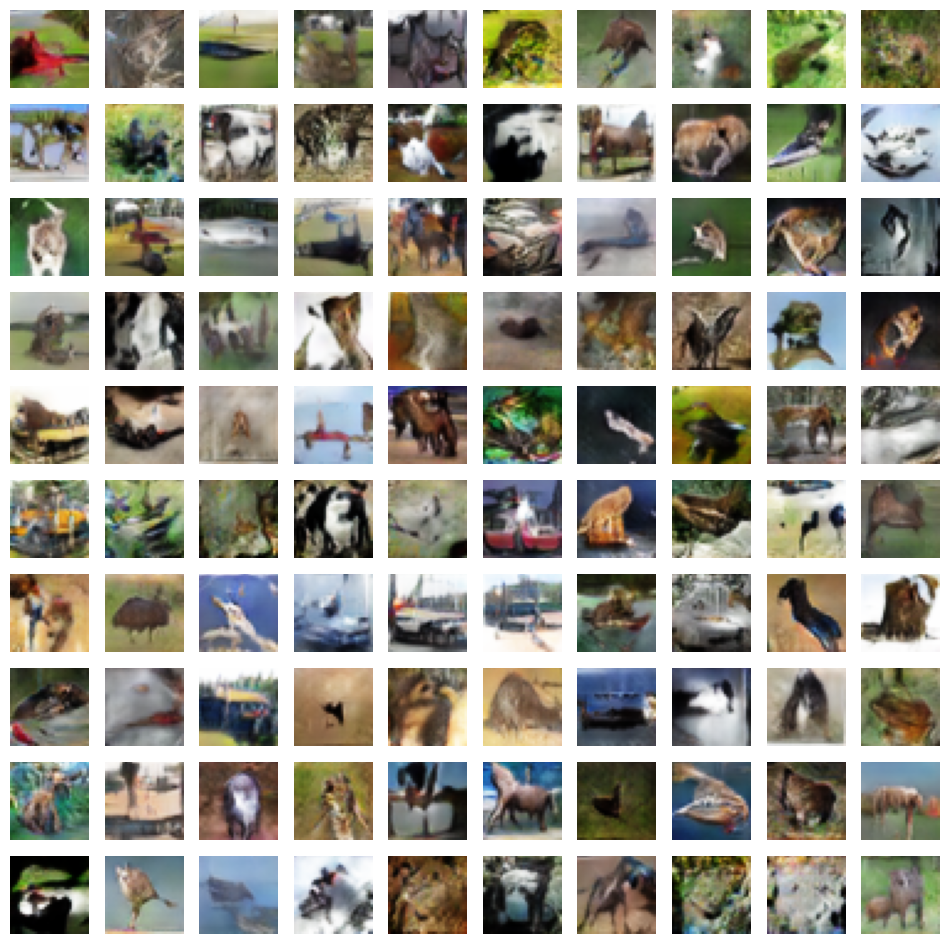

4/4 [==============================] - 2s 231ms/step
Inception Score: Mean = 1.000321626663208, Std = 0.00010449514229549095


In [101]:
# plot the generated images
def create_plot(examples, n,figsize=(12,12)):
    plt.figure(figsize=figsize)
    # plot images
    for i in range(n * n):
        # define subplot
        plt.subplot(n, n, 1 + i)
        # turn off axis
        plt.axis('off')
        # plot raw pixel data
        plt.imshow(examples[i, :, :])
    plt.show()

    is_mean, is_std = inception_score(examples)
    print(f'Inception Score: Mean = {is_mean}, Std = {is_std}')


# generate images
latent_points = generate_latent_points(100, 100)
# generate images
X = best_g_model.predict(latent_points)
# scale from [-1,1] to [0,1]
X = (X + 1) / 2.0
# plot the result

create_plot(X, 10)

32/32 [==============================] - 1s 22ms/step


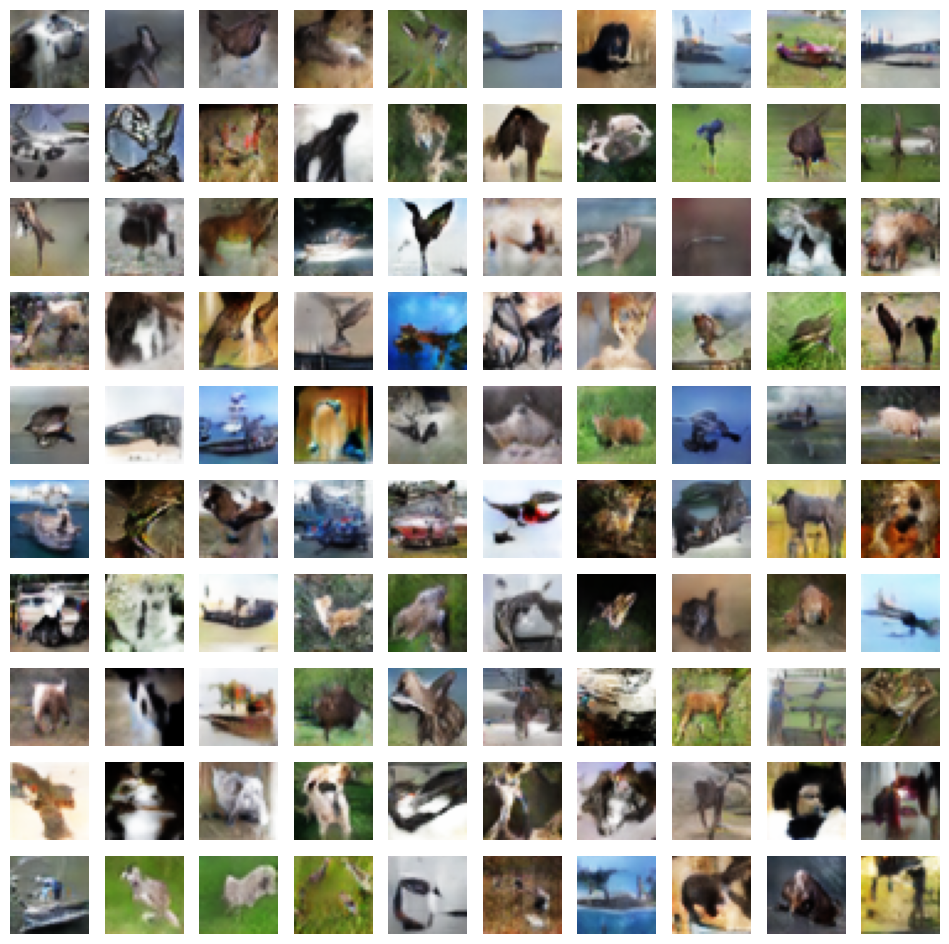

4/4 [==============================] - 1s 262ms/step
Inception Score: Mean = 1.0003156661987305, Std = 0.00010003775241784751


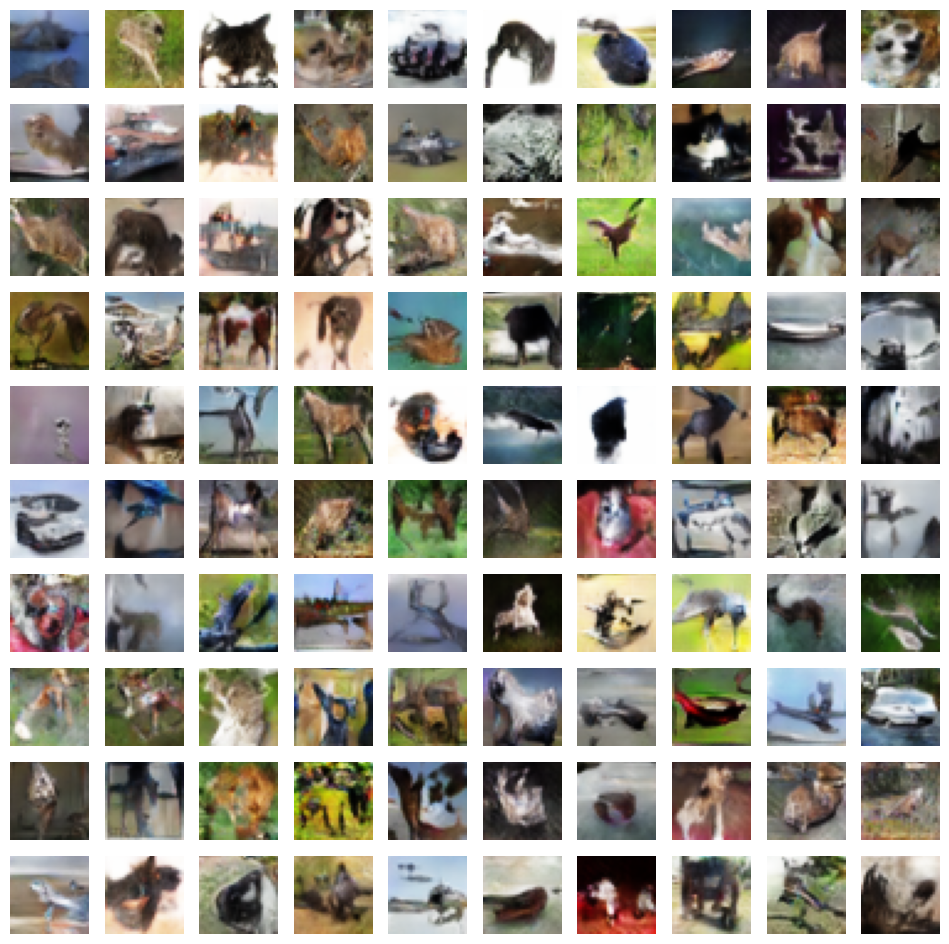

4/4 [==============================] - 1s 283ms/step
Inception Score: Mean = 1.0003535747528076, Std = 7.59176182327792e-05


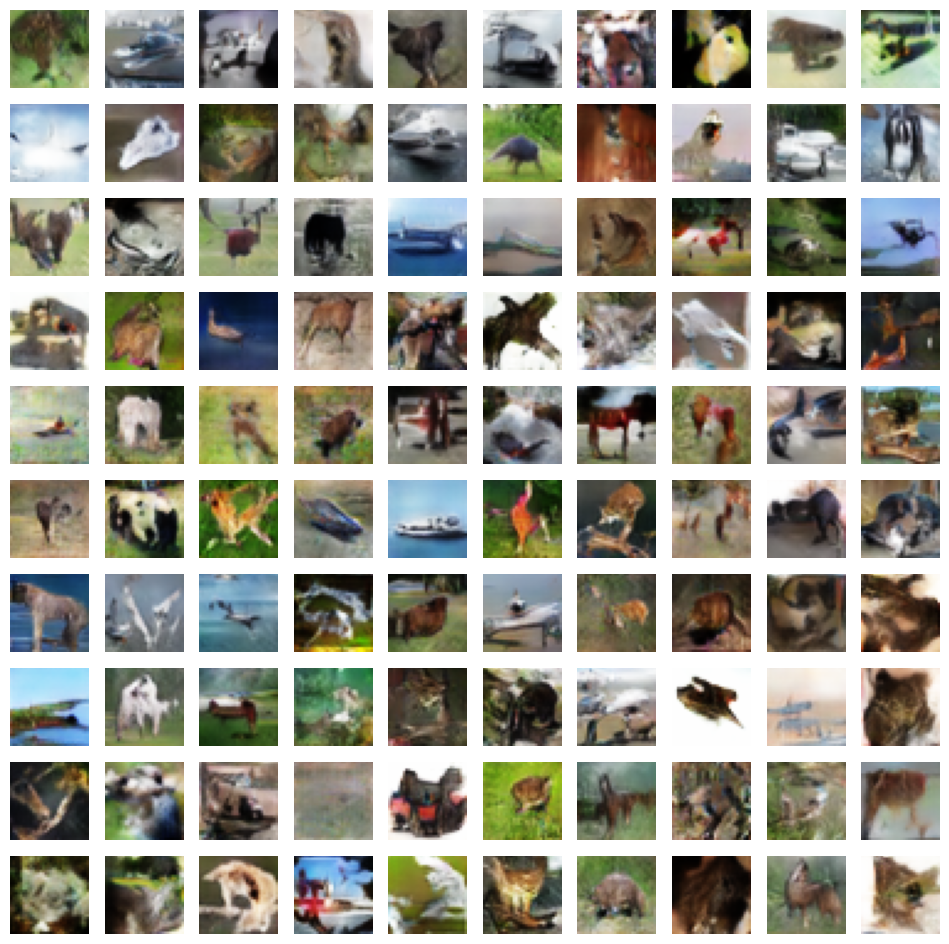

4/4 [==============================] - 1s 277ms/step
Inception Score: Mean = 1.0003058910369873, Std = 6.08931622991804e-05


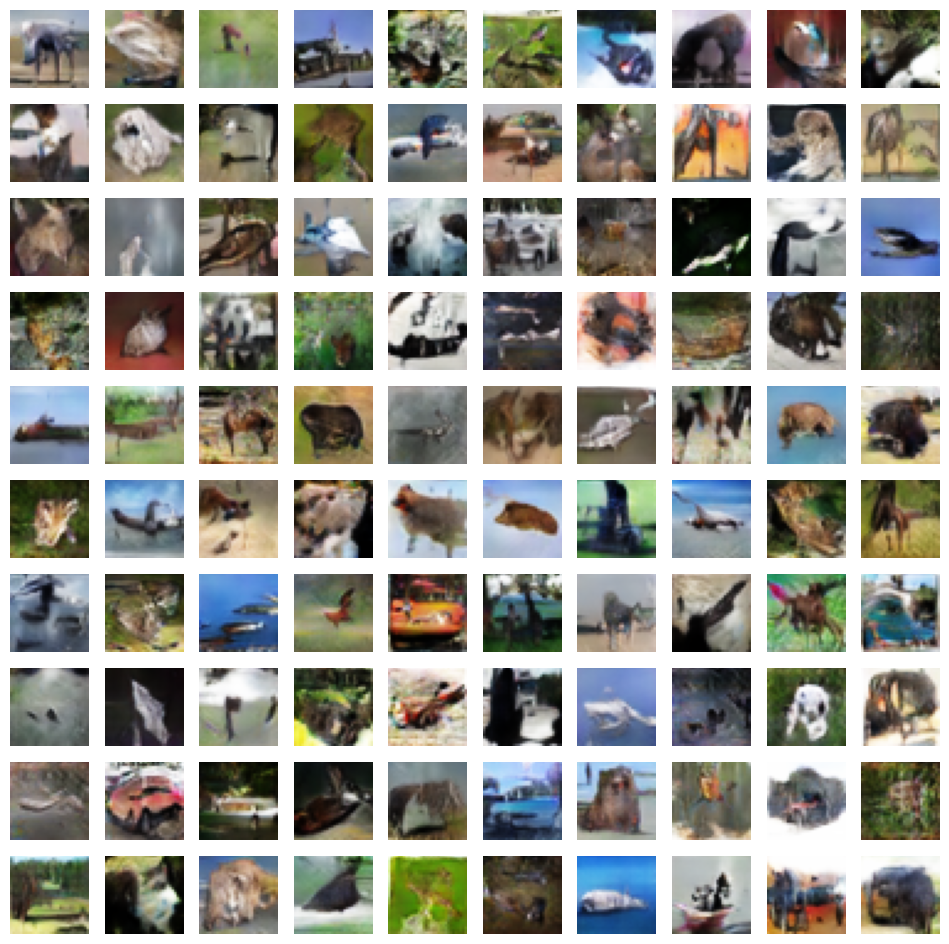

4/4 [==============================] - 1s 298ms/step
Inception Score: Mean = 1.0003302097320557, Std = 0.00010661099076969549


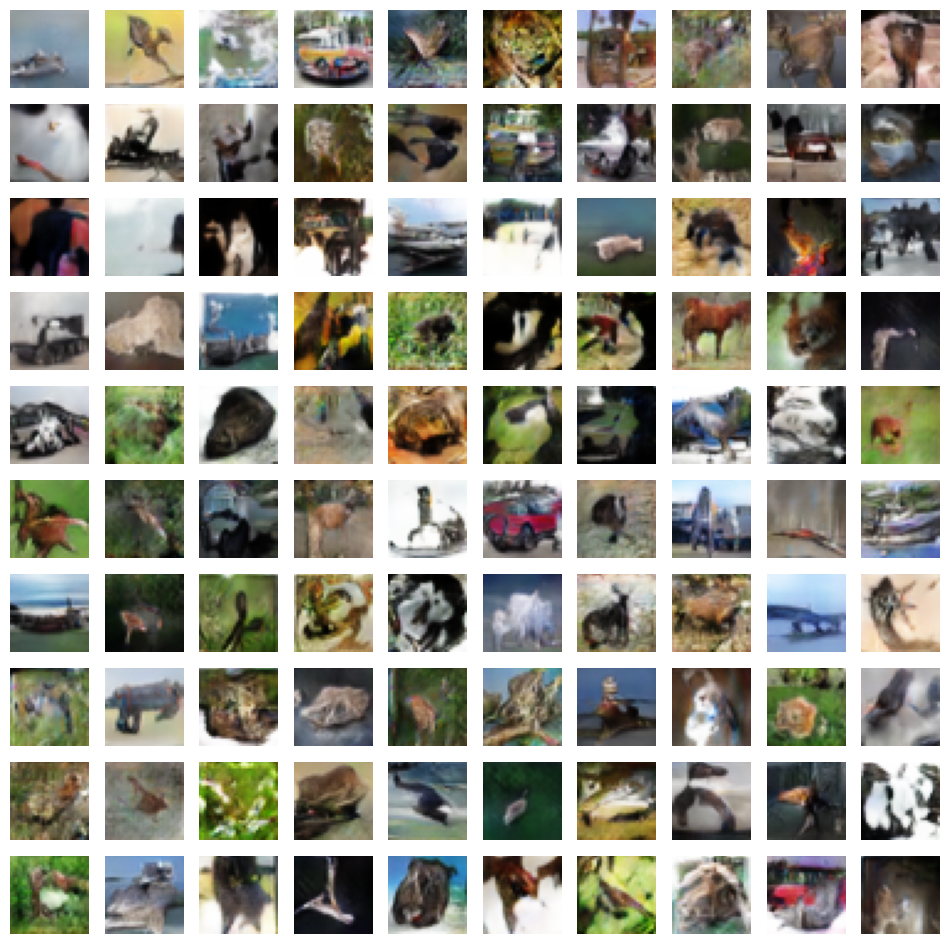

4/4 [==============================] - 1s 284ms/step
Inception Score: Mean = 1.000364899635315, Std = 0.00010827500955201685


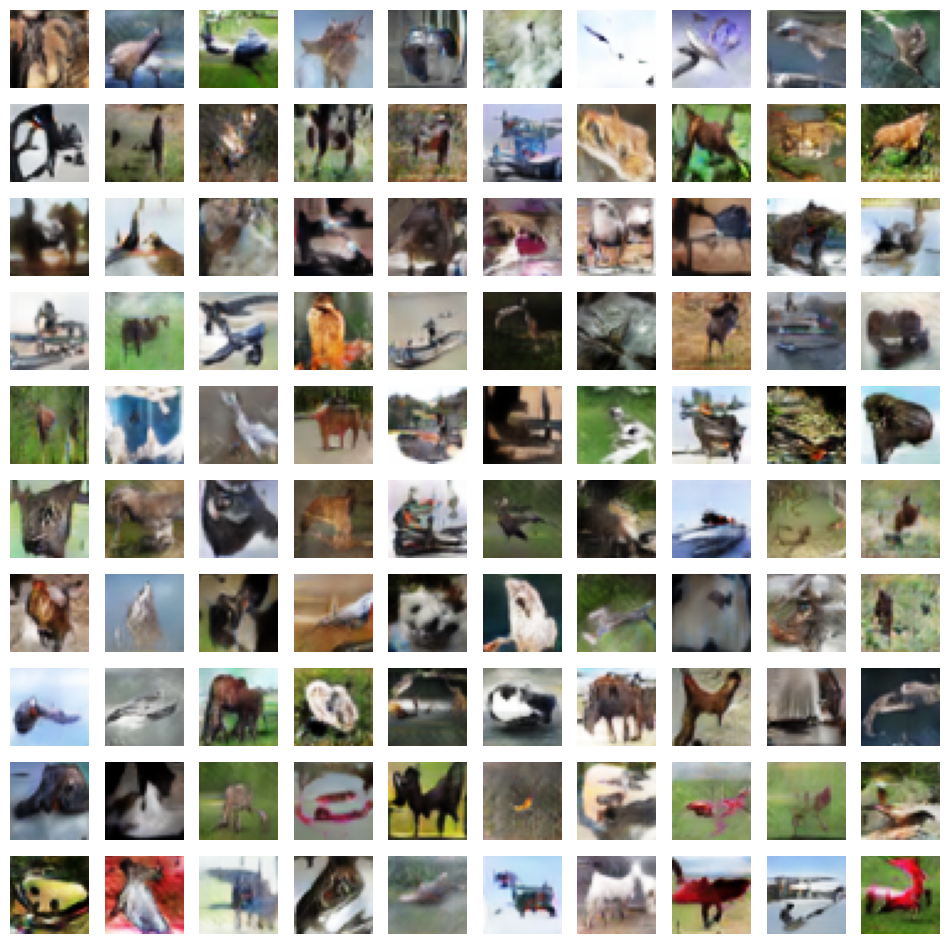

4/4 [==============================] - 1s 289ms/step
Inception Score: Mean = 1.0003433227539062, Std = 8.674449054524302e-05


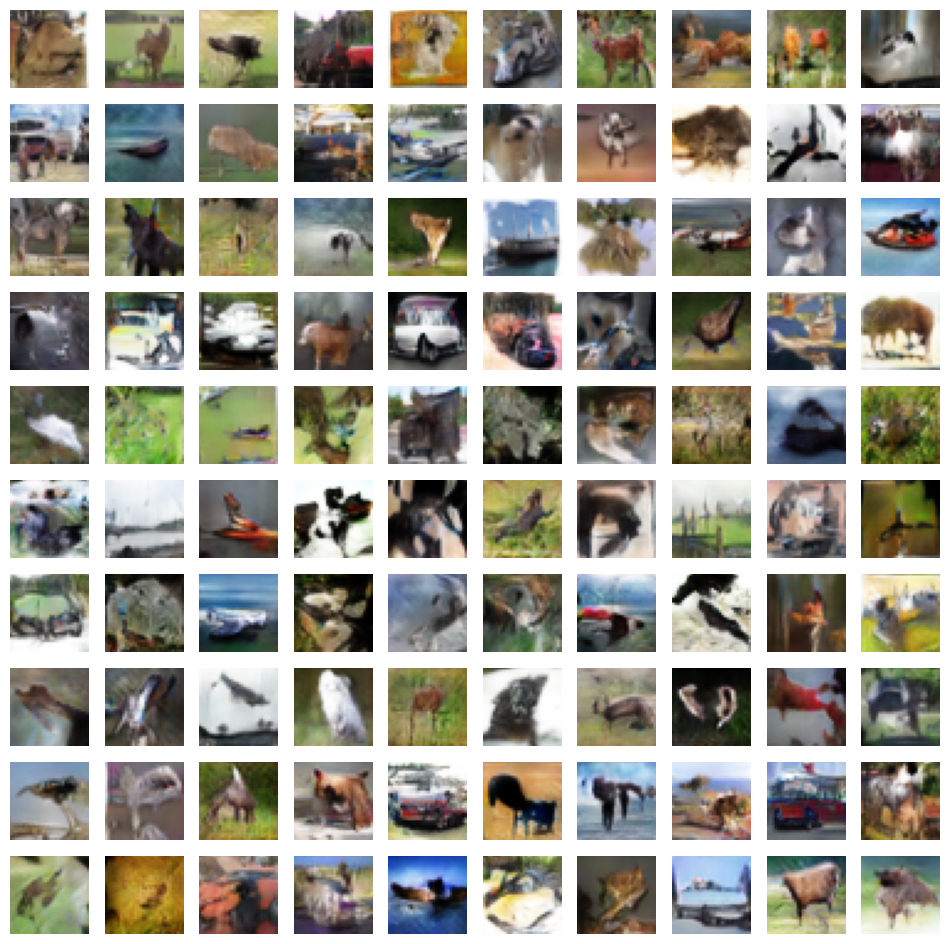

4/4 [==============================] - 1s 286ms/step
Inception Score: Mean = 1.0003076791763306, Std = 0.00013298362318892032


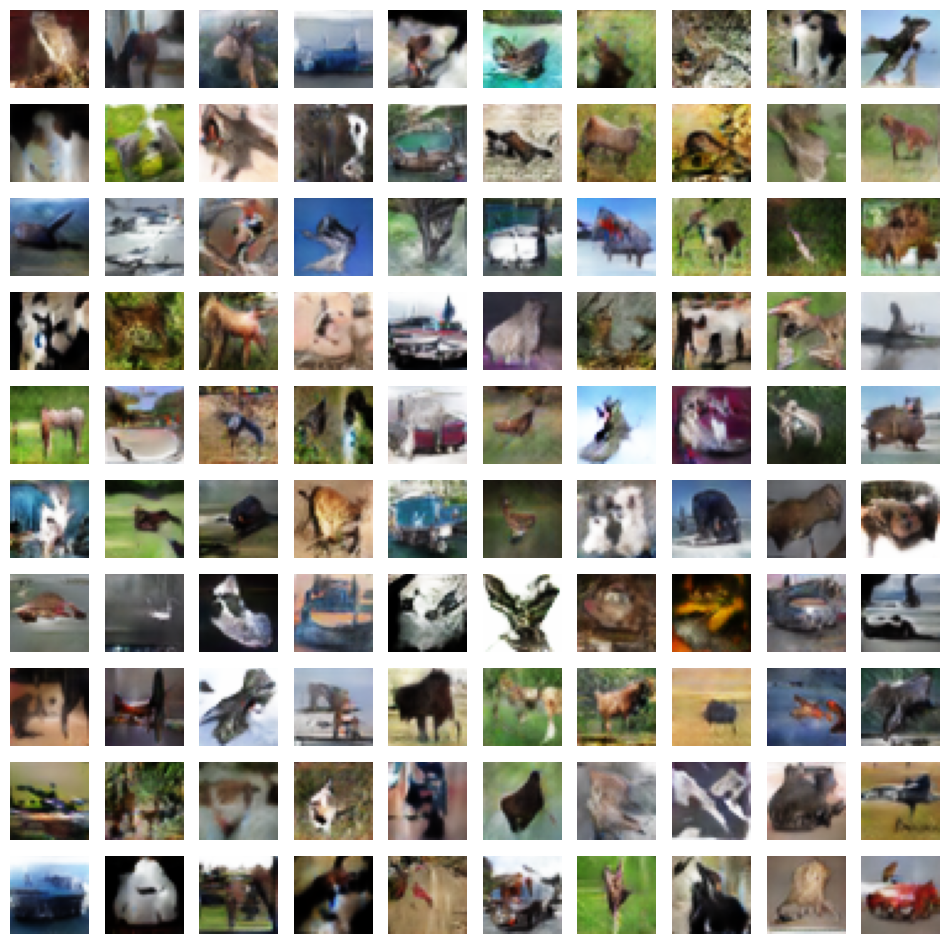

4/4 [==============================] - 1s 276ms/step
Inception Score: Mean = 1.0003669261932373, Std = 0.00012869600323028862


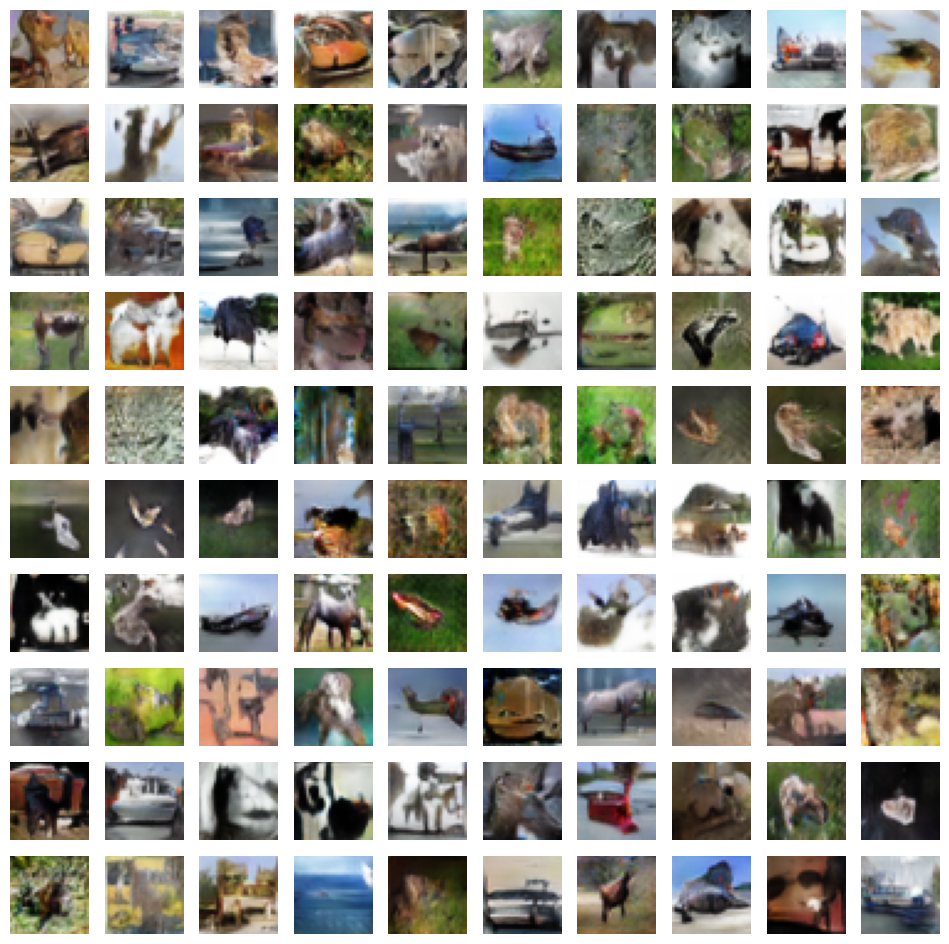

4/4 [==============================] - 1s 284ms/step
Inception Score: Mean = 1.0002838373184204, Std = 8.413189061684534e-05


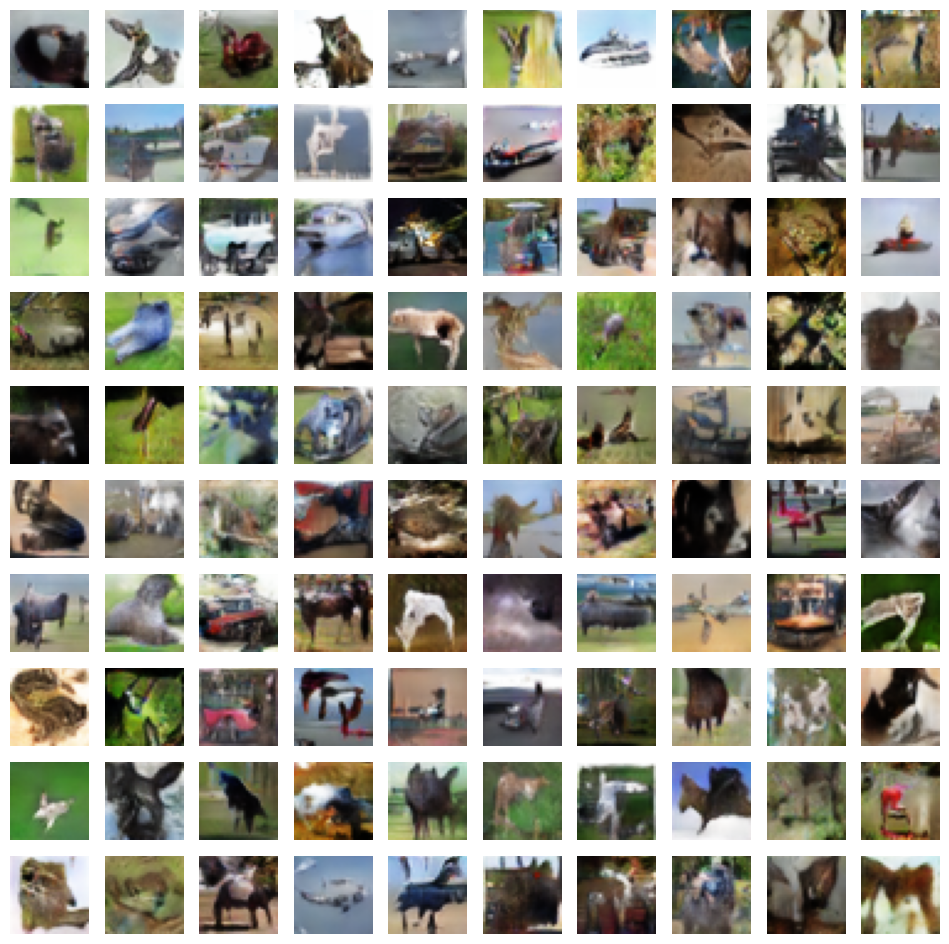

4/4 [==============================] - 1s 272ms/step
Inception Score: Mean = 1.0003219842910767, Std = 0.00010847624071175233


In [104]:
# Load real images
real_images = load_real_samples()

# Generate fake images
latent_points = generate_latent_points(100, 1000)  # Generate 1000 latent points for 10 plots with 100 images each
fake_images = best_g_model.predict(latent_points)
fake_images = (fake_images + 1) / 2.0

# Plot and save each plot
for i in range(10):
    start_idx = i * 100
    end_idx = (i + 1) * 100
    create_plot(fake_images[start_idx:end_idx], 10, figsize=(12, 12))
    plt.show()


### data augmentation

In [52]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.cifar10.load_data()
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

In [53]:
datagen = ImageDataGenerator(
    # rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    # shear_range=0.2,
    # zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

In [54]:
def display_augmented_images(X_train, y_train, datagen):
    for i in range(10):
        img = X_train[i]
        img = img.reshape((1,) + img.shape)

        # generate augmented images and display them
        fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12, 2))

        for j, batch in enumerate(datagen.flow(img, batch_size=1)):
            ax[j].imshow(batch[0].astype('uint8'))  # Convert to uint8 for display
            ax[j].axis('off')

            if j == 4:
                break

        # display the class name (labels)
        plt.suptitle(f"Class: {class_names[y_train[i][0]]}", y=1.02)
        plt.show()

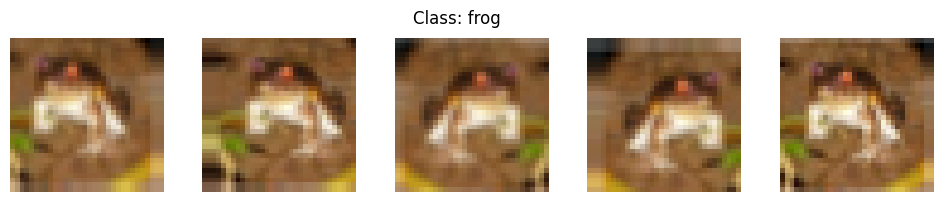

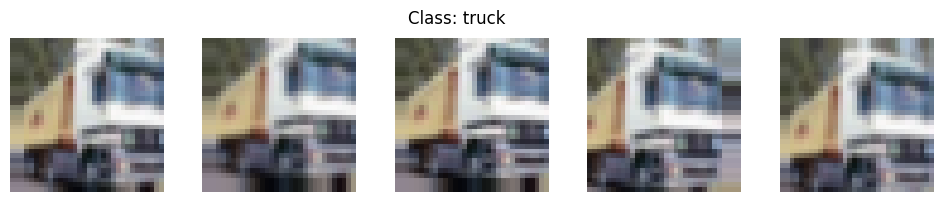

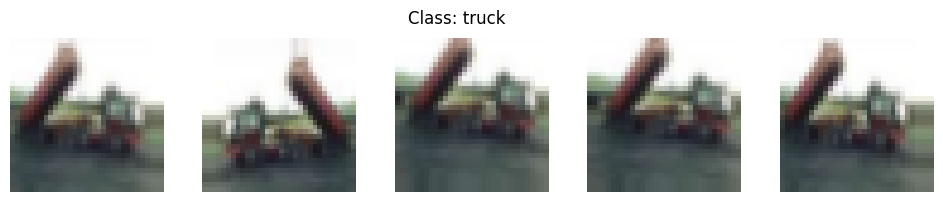

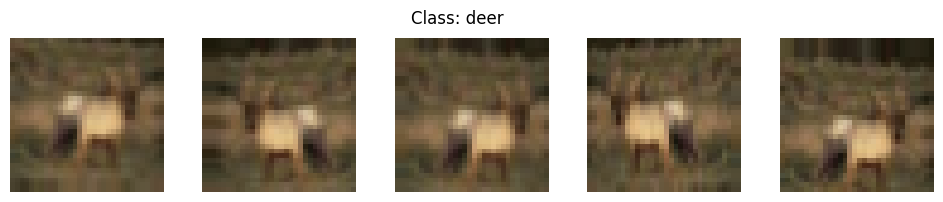

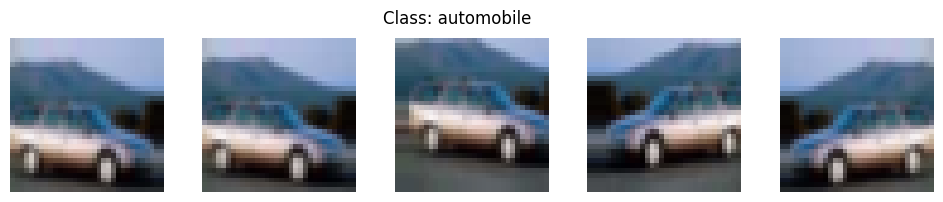

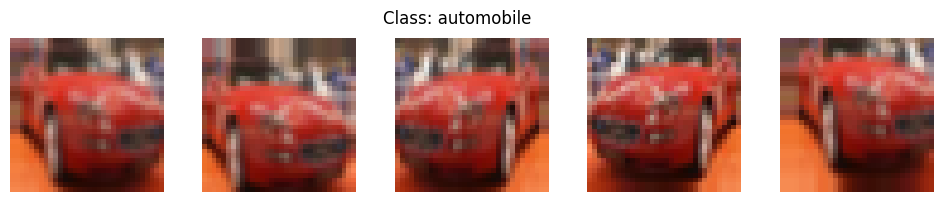

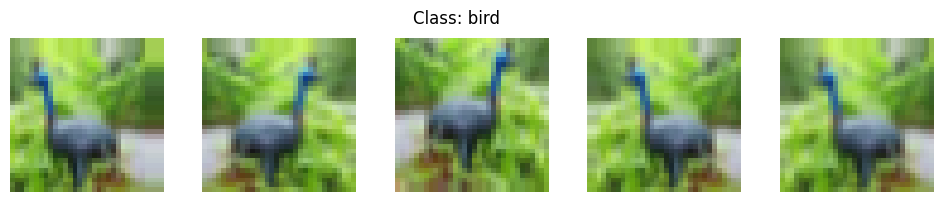

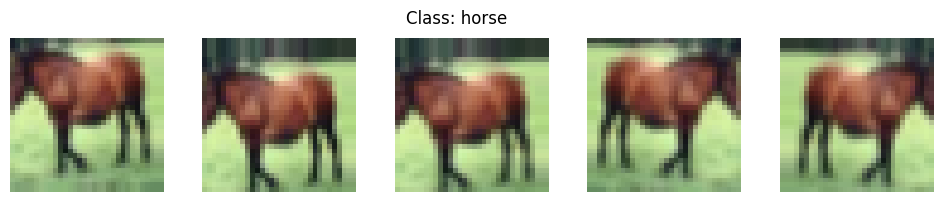

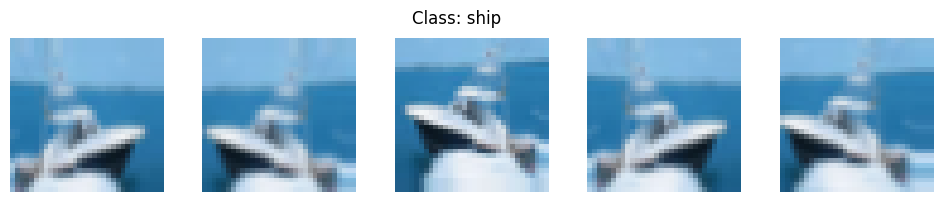

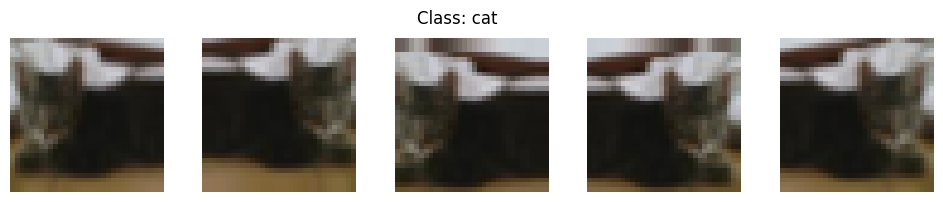

In [55]:
display_augmented_images(X_train, y_train, datagen)

In [56]:
datagen.fit(X_train)

# Augment the dataset
augmented_images = []
augmented_labels = []

for X_batch, y_batch in datagen.flow(X_train, y_train, batch_size=len(X_train), shuffle=False):
    augmented_images.extend(X_batch)
    augmented_labels.extend(y_batch)
    break  # Ensure only one iteration

# Convert lists to numpy arrays
augmented_images = np.array(augmented_images)
augmented_labels = np.array(augmented_labels)

# Concatenate augmented dataset with original dataset
X_train = np.concatenate((X_train, augmented_images))
y_train = np.concatenate((y_train, augmented_labels))

# Shuffle the dataset
shuffle_index = np.random.permutation(len(X_train))
X_train = X_train[shuffle_index]
y_train = y_train[shuffle_index]

# Display dataset information
print("Augmented training set shape:", X_train.shape)
print("Number of augmented training samples:", X_train.shape[0])
print("Image shape:", X_train[0].shape)
print("Label shape:", y_train.shape)

Augmented training set shape: (100000, 32, 32, 3)
Number of augmented training samples: 100000
Image shape: (32, 32, 3)
Label shape: (100000, 1)


In [62]:
def display_images(X_train, y_train, class_names):
    fig, axes = plt.subplots(5, 10, figsize=(20, 10))

    for ax in axes.flatten():
        ax.axis('off')

    for class_label in range(10):
        class_images = X_train[y_train.flatten() == class_label]

        for i, ax in enumerate(axes[:, class_label]):
            img = class_images[i] / 255.0  # Normalize pixel values to [0, 1]
            ax.imshow(img)
            ax.set_title(class_names[class_label])
            ax.axis('off')
            ax.set_aspect('equal')

    plt.tight_layout()
    plt.show()

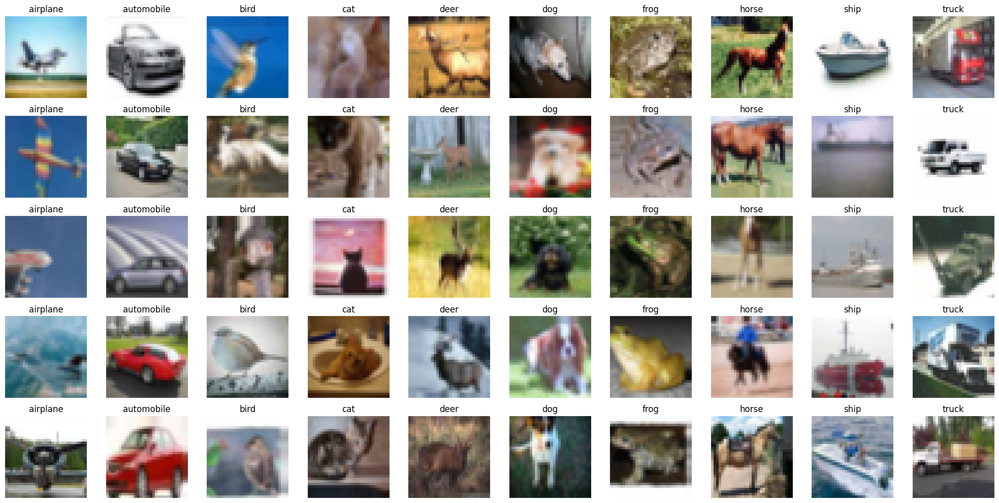

In [63]:
display_images(X_train, y_train, class_names)

In [39]:
def load_augmented_real_samples(datagen, dataset, n_samples):
    # Apply augmentation to real samples
    augmented_samples = []
    for i in range(n_samples):
        ix = np.random.randint(0, dataset.shape[0])
        image = dataset[ix]
        image = datagen.random_transform(image)
        augmented_samples.append(image)
    augmented_samples = np.array(augmented_samples)
    # Generate 'real' class labels (1)
    y = np.ones((n_samples, 1))
    return augmented_samples, y

In [40]:
def generate_augmented_fake_samples(datagen, g_model, latent_dim, n_samples):
    # Generate points in latent space
    x_input = generate_latent_points(latent_dim, n_samples)
    # Generate fake images
    X = g_model.predict(x_input)
    # Apply augmentation to fake samples
    augmented_samples = datagen.flow(X, batch_size=n_samples, shuffle=False).next()
    # Generate 'fake' class labels (0)
    y = np.zeros((n_samples, 1))
    return augmented_samples, y

In [41]:
def train(g_model, d_model, gan_model, dataset, latent_dim=100, n_epochs=200, n_batch=128):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)
    d_losses = []
    g_losses = []
    for i in range(n_epochs):
        for j in range(bat_per_epo):
            # Get augmented 'real' samples
            X_real, y_real = load_augmented_real_samples(datagen, dataset, half_batch)
            # Update discriminator model weights on augmented real samples
            d_loss1, _ = d_model.train_on_batch(X_real, y_real)
            # Generate augmented 'fake' examples
            X_fake, y_fake = generate_augmented_fake_samples(datagen, g_model, latent_dim, half_batch)
            # Update discriminator model weights on augmented fake samples
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            # Prepare points in latent space for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # Create inverted labels for the fake samples
            y_gan = np.ones((n_batch, 1))
            # Update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # Summarize loss on this batch
            print('Epoch %d/%d, Batch %d/%d, d1=%.3f, d2=%.3f, g=%.3f' %
                  (i+1, n_epochs, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
            
             # Append discriminator and generator losses
            d_losses.append((d_loss1 + d_loss2) / 2)
            g_losses.append(g_loss)

        print(f'Epoch {i+1}/{n_epochs} completed.')
        if (i+1) % 10 == 0:
            summarize_performance(i, g_model, d_model, dataset, latent_dim, 'augmented')
    return d_losses, g_losses

In [42]:
# train(g_model, d_model, gan_model, dataset)

2/2 [==============================] - 0s 80ms/step
Epoch 1/200, Batch 1/390, d1=0.583, d2=0.573, g=1.304
2/2 [==============================] - 0s 33ms/step
Epoch 1/200, Batch 2/390, d1=0.822, d2=0.654, g=1.275
2/2 [==============================] - 0s 17ms/step
Epoch 1/200, Batch 3/390, d1=0.774, d2=0.729, g=1.323
2/2 [==============================] - 0s 17ms/step
Epoch 1/200, Batch 4/390, d1=0.720, d2=0.568, g=1.315
2/2 [==============================] - 0s 17ms/step
Epoch 1/200, Batch 5/390, d1=0.759, d2=0.762, g=1.180
2/2 [==============================] - 0s 38ms/step
Epoch 1/200, Batch 6/390, d1=0.744, d2=0.703, g=1.258
2/2 [==============================] - 0s 32ms/step
Epoch 1/200, Batch 7/390, d1=0.865, d2=0.679, g=1.255
2/2 [==============================] - 0s 15ms/step
Epoch 1/200, Batch 8/390, d1=0.731, d2=0.624, g=1.104
2/2 [==============================] - 0s 19ms/step
Epoch 1/200, Batch 9/390, d1=0.697, d2=0.567, g=1.045
2/2 [==============================] - 0s 33ms

KeyboardInterrupt: 

90% accuracy however mode collapse

### loading model

In [64]:
# load model
weight_location = os.path.join("augmented_weights","generator_model_130.h5")
best_aug_g_model = load_model(weight_location)

In [65]:
# Compile the loaded model
opt = Adam(learning_rate=0.0002, beta_1=0.5)
best_aug_g_model.compile(optimizer=opt, loss='binary_crossentropy')

In [66]:
with tf.device('/CPU:0'):
    # Generate fake samples
    fake_images, _ = generate_fake_samples(best_aug_g_model, latent_dim, 100)

    # Calculate Inception Score
    is_mean, is_std = inception_score(fake_images)
    print("Inception Score: Mean =", is_mean, "Std =", is_std)

4/4 [==============================] - 1398s 324s/step
Inception Score: Mean = 1.0006224 Std = 0.00011758676


In [ ]:
# train_dataset = tf.data.Dataset.from_tensor_slices(X_train)
# train_dataset = train_dataset.shuffle(buffer_size=1024).batch(128)

In [ ]:
(X_train2, _), (_, _) = tf.keras.datasets.cifar10.load_data()
X_train2 = np.reshape((X_train2).astype("float32"), (-1, 32, 32, 3))
train_dataset2 = tf.data.Dataset.from_tensor_slices(X_train2)
train_dataset2 = train_dataset2.shuffle(buffer_size=1024).batch(128)

In [ ]:
# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
    model = Sequential()
    # normal
    model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2)) #downsampling

    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Flatten())
    model.add(Dropout(0.4)) #prevents overfitting
    model.add(Dense(1, activation='sigmoid')) #discriminator is binary classifier (real or fake)
    
    return model

def define_generator(latent_dim):
    model = Sequential()
    # foundation for 4x4 image
    n_nodes = 256 * 4 * 4
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((4, 4, 256)))
    # upsample to 8x8
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 16x16
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 32x32
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # output layer
    model.add(Conv2D(3, (3,3), activation='tanh', padding='same'))
    
    return model

In [ ]:
g = define_generator(100)
d = define_discriminator()

In [ ]:
d_opt = Adam(lr=0.00001, beta_1=0.5)
g_opt = Adam(lr=0.0002, beta_1=0.5)

c:\Users\p2201902\.conda\envs\gpu_env\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [ ]:
loss_fn = BinaryCrossentropy()

In [ ]:
@tf.function
def train_step(real_images):
    # Sample random points in the latent space
    random_latent_vectors = tf.random.normal(shape=(128, 100))
    # Decode them to fake images
    generated_images = g(random_latent_vectors)
    # Combine them with real images
    combined_images = tf.concat([generated_images, real_images], axis=0)

    # Assemble labels discriminating real from fake images
    labels = tf.concat(
        [tf.ones((128, 1)), tf.zeros((real_images.shape[0], 1))], axis=0
    )
    # Add random noise to the labels - important trick!
    labels += 0.05 * tf.random.uniform(labels.shape)

    # Train the discriminator
    with tf.GradientTape() as tape:
        predictions = d(combined_images)
        d_loss = loss_fn(labels, predictions)
    grads = tape.gradient(d_loss, d.trainable_weights)
    d_opt.apply_gradients(zip(grads, d.trainable_weights))

    # Sample random points in the latent space
    random_latent_vectors = tf.random.normal(shape=(128, 100))
    # Assemble labels that say "all real images"
    misleading_labels = tf.zeros((128, 1))

    # Train the generator (note that we should *not* update the weights
    # of the discriminator)!
    with tf.GradientTape() as tape:
        predictions = d(g(random_latent_vectors))
        g_loss = loss_fn(misleading_labels, predictions)
    grads = tape.gradient(g_loss, g.trainable_weights)
    g_opt.apply_gradients(zip(grads, g.trainable_weights))
    return d_loss, g_loss, generated_images

In [ ]:
save_dir = os.path.join(os.getcwd(), 'aug2_img_gan')


for epoch in range(100):
    print("\nStart epoch", epoch)

    for step, real_images in enumerate(train_dataset2):
        # Train the discriminator & generator on one batch of real images.
        d_loss, g_loss, generated_images = train_step(real_images)

        # Logging.
        if step % 200 == 0:
            # Print metrics
            print("discriminator loss at step %d: %.2f" % (step, d_loss))
            print("adversarial loss at step %d: %.2f" % (step, g_loss))
            
            # Save one generated image
            img = keras.utils.array_to_img(generated_images[0] * 255.0, scale=False)
            img.save(os.path.join(save_dir, "generated_img" + str(epoch) + "_" + str(step) + ".png"))
            


Start epoch 0
discriminator loss at step 0: -0.20
adversarial loss at step 0: 23.70
discriminator loss at step 200: -0.12
adversarial loss at step 200: 24.69


KeyboardInterrupt: 

#### 